# Analyzing NYC Taxi Fares with RAPIDS

[RAPIDS](https://rapids.ai/) is a suite of GPU accelerated data science libraries with APIs that should be familiar to users of Pandas, Dask, and Scikitlearn.

The New York City Taxi and Limousine Commission provides (anonymized) data on all of the trips taken in New York as a series of Parquet files.

This notebook builds a simple data pipeline to load the data with cuDF (or Pandas), analyze it with cuML (or scikit-learn), find interesting patterns in the data, and build a simple predictive model on top of it.

In [1]:
import os
import requests

import numpy as np
import pandas as pd
from tqdm.auto import tqdm

import cudf
import cuml

# Getting the data

You only need to run this once when you start working on the notebook! It will cache the data locally. 

In [2]:
def download(url, fname):
    # this code adapted from the tqdm examples
    # https://github.com/tqdm/tqdm/blob/master/examples/tqdm_requests.py
    if os.path.exists(fname):
        return
    response = requests.get(url, stream=True)
    with tqdm.wrapattr(
        open(fname, "wb"), "write",
        unit='B', unit_scale=True, unit_divisor=1024, miniters=1,
        desc=fname, total=int(response.headers.get('content-length', 0))
    ) as fout:
        for chunk in response.iter_content(chunk_size=4096):
            fout.write(chunk)

def download_taxi_data():
    base = "https://d37ci6vzurychx.cloudfront.net/trip-data/"
    fname = "yellow_tripdata_2021-{i:02d}.parquet"
    url = base + fname
    for i in range(1, 13):  # 12 months of data
        download(url.format(i=i), fname.format(i=i))
    
def download_taxi_zones():
    download(
        "https://raw.githubusercontent.com/shwina/rapids-tutorial-gtc-2023/master/taxi_zones.csv?token=GHSAT0AAAAAAB4LHVK6US5ICH2ZZMTAVXMUY7YAMHQ",
        "taxi_zones.csv"
    )
    
# download_taxi_data()
# download_taxi_zones()

# Inspecting the Data

Let's start with a familiar Pandas approach, and then use cuDF to do the same thing.

In [3]:
%%time

df = pd.read_parquet('yellow_tripdata_2021-01.parquet')
display(df)

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,airport_fee
0,1,2021-01-01 00:30:10,2021-01-01 00:36:12,1.0,2.10,1.0,N,142,43,2,8.00,3.00,0.5,0.00,0.00,0.3,11.80,2.5,NaN
1,1,2021-01-01 00:51:20,2021-01-01 00:52:19,1.0,0.20,1.0,N,238,151,2,3.00,0.50,0.5,0.00,0.00,0.3,4.30,0.0,NaN
2,1,2021-01-01 00:43:30,2021-01-01 01:11:06,1.0,14.70,1.0,N,132,165,1,42.00,0.50,0.5,8.65,0.00,0.3,51.95,0.0,NaN
3,1,2021-01-01 00:15:48,2021-01-01 00:31:01,0.0,10.60,1.0,N,138,132,1,29.00,0.50,0.5,6.05,0.00,0.3,36.35,0.0,NaN
4,2,2021-01-01 00:31:49,2021-01-01 00:48:21,1.0,4.94,1.0,N,68,33,1,16.50,0.50,0.5,4.06,0.00,0.3,24.36,2.5,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1369764,2,2021-01-31 23:03:00,2021-01-31 23:33:00,NaN,8.89,NaN,None,229,181,0,27.78,0.00,0.5,7.46,0.00,0.3,38.54,NaN,NaN
1369765,2,2021-01-31 23:29:00,2021-01-31 23:51:00,NaN,7.43,NaN,None,41,70,0,32.58,0.00,0.5,0.00,6.12,0.3,39.50,NaN,NaN
1369766,2,2021-01-31 23:25:00,2021-01-31 23:38:00,NaN,6.26,NaN,None,74,137,0,16.85,0.00,0.5,3.90,0.00,0.3,24.05,NaN,NaN
1369767,6,2021-01-31 23:01:06,2021-02-01 00:02:03,NaN,19.70,NaN,None,265,188,0,53.68,0.00,0.5,0.00,0.00,0.3,54.48,NaN,NaN


CPU times: user 712 ms, sys: 464 ms, total: 1.18 s
Wall time: 165 ms


In [4]:
%%time
# TODO: Read the CSV with cudf into gdf_2021

gdf = cudf.read_parquet('yellow_tripdata_2021-01.parquet')
display(gdf)

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,airport_fee
0,1,2021-01-01 00:30:10,2021-01-01 00:36:12,1.0,2.10,1.0,N,142,43,2,8.00,3.00,0.5,0.00,0.00,0.3,11.80,2.5,<NA>
1,1,2021-01-01 00:51:20,2021-01-01 00:52:19,1.0,0.20,1.0,N,238,151,2,3.00,0.50,0.5,0.00,0.00,0.3,4.30,0.0,<NA>
2,1,2021-01-01 00:43:30,2021-01-01 01:11:06,1.0,14.70,1.0,N,132,165,1,42.00,0.50,0.5,8.65,0.00,0.3,51.95,0.0,<NA>
3,1,2021-01-01 00:15:48,2021-01-01 00:31:01,0.0,10.60,1.0,N,138,132,1,29.00,0.50,0.5,6.05,0.00,0.3,36.35,0.0,<NA>
4,2,2021-01-01 00:31:49,2021-01-01 00:48:21,1.0,4.94,1.0,N,68,33,1,16.50,0.50,0.5,4.06,0.00,0.3,24.36,2.5,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1369764,2,2021-01-31 23:03:00,2021-01-31 23:33:00,<NA>,8.89,<NA>,<NA>,229,181,0,27.78,0.00,0.5,7.46,0.00,0.3,38.54,<NA>,<NA>
1369765,2,2021-01-31 23:29:00,2021-01-31 23:51:00,<NA>,7.43,<NA>,<NA>,41,70,0,32.58,0.00,0.5,0.00,6.12,0.3,39.50,<NA>,<NA>
1369766,2,2021-01-31 23:25:00,2021-01-31 23:38:00,<NA>,6.26,<NA>,<NA>,74,137,0,16.85,0.00,0.5,3.90,0.00,0.3,24.05,<NA>,<NA>
1369767,6,2021-01-31 23:01:06,2021-02-01 00:02:03,<NA>,19.70,<NA>,<NA>,265,188,0,53.68,0.00,0.5,0.00,0.00,0.3,54.48,<NA>,<NA>


CPU times: user 2.84 s, sys: 1.57 s, total: 4.41 s
Wall time: 4.3 s


# Data Cleanup

As usual, the data needs to be massaged a bit before we can start adding features that are useful to an ML model.

1. First, we want to work with just a subset of columns
2. We want to eemove any extraneous spaces from column names and change them to all lowercase
3. We'll cast columns to the appropriate data types (using 32-bit data types where possible for speed and memory efficiency)
3. For simplicity, we'll replace missing values ("nulls") are replaced with a sentinel value `<NA>`

In [5]:
# list of column names that need to be re-mapped
remap = {
    'tpep_pickup_datetime': 'pickup_datetime',
    'tpep_dropoff_datetime': 'dropoff_datetime',
    'ratecodeid': 'rate_code',
    'pulocationid': 'pickup_location',
    'dolocationid': 'dropoff_location'
}

# create a list of columns & dtypes the df must have
# note that float64 will be significantly slower on some GPUs (most GeForce, also Tesla T4)
must_haves = {
    'pickup_datetime': 'datetime64[ms]',
    'dropoff_datetime': 'datetime64[ms]',
    'passenger_count': 'int32',
    'trip_distance': 'float',
    'pickup_longitude': 'float',
    'pickup_latitude': 'float',
    'rate_code': 'int32',
    'dropoff_longitude': 'float',
    'dropoff_latitude': 'float',
    'fare_amount': 'float',
    'pickup_location': 'int32',
    'dropoff_location': 'int32',
    ## Ashwin: Added these
    'is_credit_card': 'int',
    'airport_fee': 'float'
}

# helper function which takes a DataFrame and fixes column types
def clean_columns(df, remap, must_haves):  
    # rename columns
    col_cleanup = {col: col.strip().lower() for col in df.columns}
    df = df.rename(columns=col_cleanup)
    df = df.rename(remap, axis=1)

    # Simplify the payment_type column
    df["is_credit_card"] = df["payment_type"] == 1

    for col in df.columns:
        # drop anything not in our expected list
        if col not in must_haves:
            print(f"Dropping ({col})")
            df = df.drop(columns=col)
            continue
        if df[col].dtype.kind in {'i', 'f'}:
            df[col] = df[col].fillna(-1)
        df[col] = df[col].astype(must_haves[col])
        
    
    return df

In [6]:
%%time
# Pandas approach

# some col-names include pre-pended spaces remove & lowercase column names
# rename columns using the supplied mapping

df = clean_columns(df, remap, must_haves)
print(df.__class__)
display(df)

Dropping (vendorid)
Dropping (store_and_fwd_flag)
Dropping (payment_type)
Dropping (extra)
Dropping (mta_tax)
Dropping (tip_amount)
Dropping (tolls_amount)
Dropping (improvement_surcharge)
Dropping (total_amount)
Dropping (congestion_surcharge)
<class 'pandas.core.frame.DataFrame'>


,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,rate_code,pickup_location,dropoff_location,fare_amount,airport_fee,is_credit_card
0,2021-01-01 00:30:10,2021-01-01 00:36:12,1,2.10,1,142,43,8.00,-1.0,0
1,2021-01-01 00:51:20,2021-01-01 00:52:19,1,0.20,1,238,151,3.00,-1.0,0
2,2021-01-01 00:43:30,2021-01-01 01:11:06,1,14.70,1,132,165,42.00,-1.0,1
3,2021-01-01 00:15:48,2021-01-01 00:31:01,0,10.60,1,138,132,29.00,-1.0,1
4,2021-01-01 00:31:49,2021-01-01 00:48:21,1,4.94,1,68,33,16.50,-1.0,1
...,...,...,...,...,...,...,...,...,...,...
1369764,2021-01-31 23:03:00,2021-01-31 23:33:00,-1,8.89,-1,229,181,27.78,-1.0,0
1369765,2021-01-31 23:29:00,2021-01-31 23:51:00,-1,7.43,-1,41,70,32.58,-1.0,0
1369766,2021-01-31 23:25:00,2021-01-31 23:38:00,-1,6.26,-1,74,137,16.85,-1.0,0
1369767,2021-01-31 23:01:06,2021-02-01 00:02:03,-1,19.70,-1,265,188,53.68,-1.0,0


CPU times: user 599 ms, sys: 403 ms, total: 1 s
Wall time: 987 ms


In [7]:
%%time
# TODO: RAPIDS approach - same as aPandas, but generate 'gdf' as output

gdf = clean_columns(gdf, remap, must_haves)
print(gdf.__class__)
display(gdf)

Dropping (vendorid)
Dropping (store_and_fwd_flag)
Dropping (payment_type)
Dropping (extra)
Dropping (mta_tax)
Dropping (tip_amount)
Dropping (tolls_amount)
Dropping (improvement_surcharge)
Dropping (total_amount)
Dropping (congestion_surcharge)
<class 'cudf.core.dataframe.DataFrame'>


,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,rate_code,pickup_location,dropoff_location,fare_amount,airport_fee,is_credit_card
0,2021-01-01 00:30:10,2021-01-01 00:36:12,1,2.10,1,142,43,8.00,-1.0,0
1,2021-01-01 00:51:20,2021-01-01 00:52:19,1,0.20,1,238,151,3.00,-1.0,0
2,2021-01-01 00:43:30,2021-01-01 01:11:06,1,14.70,1,132,165,42.00,-1.0,1
3,2021-01-01 00:15:48,2021-01-01 00:31:01,0,10.60,1,138,132,29.00,-1.0,1
4,2021-01-01 00:31:49,2021-01-01 00:48:21,1,4.94,1,68,33,16.50,-1.0,1
...,...,...,...,...,...,...,...,...,...,...
1369764,2021-01-31 23:03:00,2021-01-31 23:33:00,-1,8.89,-1,229,181,27.78,-1.0,0
1369765,2021-01-31 23:29:00,2021-01-31 23:51:00,-1,7.43,-1,41,70,32.58,-1.0,0
1369766,2021-01-31 23:25:00,2021-01-31 23:38:00,-1,6.26,-1,74,137,16.85,-1.0,0
1369767,2021-01-31 23:01:06,2021-02-01 00:02:03,-1,19.70,-1,265,188,53.68,-1.0,0


CPU times: user 89.4 ms, sys: 52.7 ms, total: 142 ms
Wall time: 138 ms


# Look at some key stats

We'll plot the data using the Seaborn library, which you can install via `pip install seaborn`. For a more general guide on how to use RAPIDS with most of the popular visualization libraries, see the viz gallery in our docs: https://docs.rapids.ai/visualization

In [8]:
import seaborn as sns

<Axes: xlabel='passenger_count', ylabel='fare_amount'>

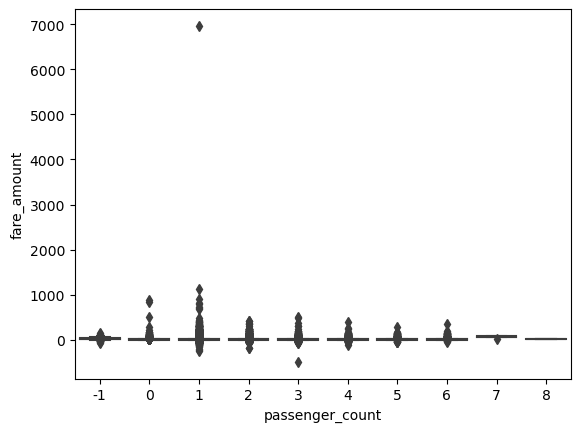

In [9]:
sns.boxplot(x="passenger_count", y="fare_amount", data=gdf.to_pandas())

# Filter the data

In [10]:
%%time

# apply a list of filter conditions to throw out records with missing or outlier values
query_frags = [
    'fare_amount > 0 and fare_amount < 500',
    'passenger_count > 0 and passenger_count < 6',
]
df = df.query(' and '.join(query_frags)).copy()

# inspect the results of cleaning
display(df)

,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,rate_code,pickup_location,dropoff_location,fare_amount,airport_fee,is_credit_card
0,2021-01-01 00:30:10,2021-01-01 00:36:12,1,2.10,1,142,43,8.0,-1.0,0
1,2021-01-01 00:51:20,2021-01-01 00:52:19,1,0.20,1,238,151,3.0,-1.0,0
2,2021-01-01 00:43:30,2021-01-01 01:11:06,1,14.70,1,132,165,42.0,-1.0,1
4,2021-01-01 00:31:49,2021-01-01 00:48:21,1,4.94,1,68,33,16.5,-1.0,1
5,2021-01-01 00:16:29,2021-01-01 00:24:30,1,1.60,1,224,68,8.0,-1.0,1
...,...,...,...,...,...,...,...,...,...,...
1271412,2021-01-31 23:58:47,2021-02-01 00:04:40,3,0.81,1,41,74,5.0,-1.0,0
1271413,2021-01-31 23:07:54,2021-01-31 23:19:42,1,3.81,1,113,141,12.5,-1.0,0
1271414,2021-01-31 23:30:45,2021-01-31 23:35:13,1,1.32,1,233,237,6.0,-1.0,0
1271415,2021-01-31 23:09:52,2021-01-31 23:51:56,2,10.56,1,56,68,37.5,-1.0,1


CPU times: user 107 ms, sys: 51.6 ms, total: 159 ms
Wall time: 146 ms


In [11]:
%%time

# TODO: RAPIDS version with "gdf_subset" as output

# apply a list of filter conditions to throw out records with missing or outlier values
query_frags = [
    'fare_amount > 0 and fare_amount < 500',
    'passenger_count > 0 and passenger_count < 6',
]
gdf = gdf.query(' and '.join(query_frags)).copy()

# inspect the results of cleaning
display(gdf)

,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,rate_code,pickup_location,dropoff_location,fare_amount,airport_fee,is_credit_card
0,2021-01-01 00:30:10,2021-01-01 00:36:12,1,2.10,1,142,43,8.0,-1.0,0
1,2021-01-01 00:51:20,2021-01-01 00:52:19,1,0.20,1,238,151,3.0,-1.0,0
2,2021-01-01 00:43:30,2021-01-01 01:11:06,1,14.70,1,132,165,42.0,-1.0,1
4,2021-01-01 00:31:49,2021-01-01 00:48:21,1,4.94,1,68,33,16.5,-1.0,1
5,2021-01-01 00:16:29,2021-01-01 00:24:30,1,1.60,1,224,68,8.0,-1.0,1
...,...,...,...,...,...,...,...,...,...,...
1271412,2021-01-31 23:58:47,2021-02-01 00:04:40,3,0.81,1,41,74,5.0,-1.0,0
1271413,2021-01-31 23:07:54,2021-01-31 23:19:42,1,3.81,1,113,141,12.5,-1.0,0
1271414,2021-01-31 23:30:45,2021-01-31 23:35:13,1,1.32,1,233,237,6.0,-1.0,0
1271415,2021-01-31 23:09:52,2021-01-31 23:51:56,2,10.56,1,56,68,37.5,-1.0,1


CPU times: user 348 ms, sys: 22.2 ms, total: 370 ms
Wall time: 364 ms


<Axes: xlabel='passenger_count', ylabel='fare_amount'>

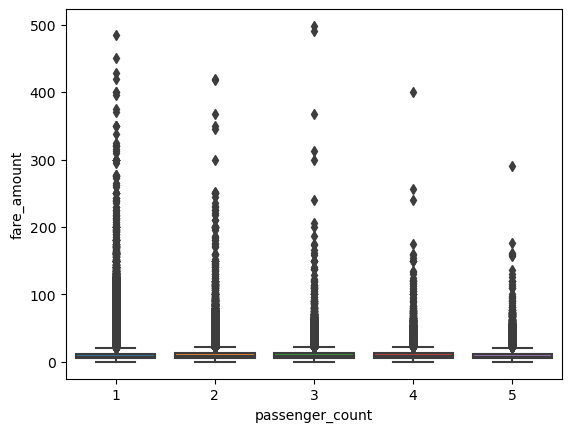

In [12]:
sns.boxplot(x="passenger_count", y="fare_amount", data=df)

# Demo 3: Adding rich features 

cuDF provides standard DataFrame operations, but also let you run "user defined functions" on the underlying data.

cuDF's [apply_rows](https://rapidsai.github.io/projects/cudf/en/0.6.0/api.html#cudf.dataframe.DataFrame.apply_rows) operation is similar to Pandas's [DataFrame.apply](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.apply.html), except that for cuDF, custom Python code is [JIT compiled by numba](https://numba.pydata.org/numba-doc/dev/cuda/kernels.html) into GPU kernels.

We'll use a Haversine Distance calculation to find total trip distance, and extract additional useful variables from the datetime fields.

In [13]:
## Ashwin: Can we explain snakeviz and remind to install it
%load_ext snakeviz

In [14]:
%%time

def add_pickup_and_dropoff_coordinates(df):
    taxi_zones = pd.read_csv("taxi_zones.csv")
    
    df['trip_index'] = range(len(df))
    
    ## Ashwin, can we filter to remove missing locations
    pickup_merged = df.merge(taxi_zones, left_on='pickup_location', right_on='LocationID', how='inner')
    dropoff_merged = df.merge(taxi_zones, left_on='dropoff_location', right_on='LocationID', how='inner')
    pickup_merged.reset_index(drop=True)
    dropoff_merged.reset_index(drop=True)
    df['pickup_latitude'] = pickup_merged['y']
    df['pickup_longitude'] = pickup_merged['x']
    df['dropoff_latitude'] = dropoff_merged['y']
    df['dropoff_longitude'] = dropoff_merged['x']
    
    ## Ashwin, shouldn't my inner join above take care of this?
    ## Also, do we need the helper function twice?
    df = df.dropna()

    return df

df = add_pickup_and_dropoff_coordinates(df)
display(df)

,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,rate_code,pickup_location,dropoff_location,fare_amount,airport_fee,is_credit_card,trip_index,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude
0,2021-01-01 00:30:10,2021-01-01 00:36:12,1,2.10,1,142,43,8.0,-1.0,0,0,40.773633,-73.981532,40.782478,-73.965554
1,2021-01-01 00:51:20,2021-01-01 00:52:19,1,0.20,1,238,151,3.0,-1.0,0,1,40.773633,-73.981532,40.782478,-73.965554
2,2021-01-01 00:43:30,2021-01-01 01:11:06,1,14.70,1,132,165,42.0,-1.0,1,2,40.773633,-73.981532,40.782478,-73.965554
4,2021-01-01 00:31:49,2021-01-01 00:48:21,1,4.94,1,68,33,16.5,-1.0,1,3,40.773633,-73.981532,40.782478,-73.965554
5,2021-01-01 00:16:29,2021-01-01 00:24:30,1,1.60,1,224,68,8.0,-1.0,1,4,40.773633,-73.981532,40.782478,-73.965554
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1201185,2021-01-29 20:46:53,2021-01-29 20:52:21,5,0.63,1,142,142,5.0,-1.0,1,1145052,40.672090,-73.773036,40.652137,-73.990235
1201186,2021-01-29 20:32:53,2021-01-29 20:44:02,2,2.44,1,166,142,11.0,-1.0,1,1145053,40.672090,-73.773036,40.652137,-73.990235
1201187,2021-01-29 20:37:18,2021-01-29 20:46:12,2,1.90,1,170,249,8.5,-1.0,1,1145054,40.672090,-73.773036,40.652137,-73.990235
1201188,2021-01-29 20:48:24,2021-01-29 20:58:55,2,1.90,1,249,170,9.5,-1.0,1,1145055,40.672090,-73.773036,40.652137,-73.990235


CPU times: user 799 ms, sys: 295 ms, total: 1.09 s
Wall time: 1.08 s


In [15]:
%%time

def add_pickup_and_dropoff_coordinates(df):
    taxi_zones = cudf.read_csv("taxi_zones.csv")
    
    df['trip_index'] = range(len(df))
    pickup_merged = df.merge(taxi_zones, left_on='pickup_location', right_on='LocationID', how='inner')
    dropoff_merged = df.merge(taxi_zones, left_on='dropoff_location', right_on='LocationID', how='inner')
    pickup_merged = pickup_merged.sort_values("trip_index").reset_index(drop=True)
    dropoff_merged = dropoff_merged.sort_values("trip_index").reset_index(drop=True)
    df['pickup_latitude'] = pickup_merged['y']
    df['pickup_longitude'] = pickup_merged['x']
    df['dropoff_latitude'] = dropoff_merged['y']
    df['dropoff_longitude'] = dropoff_merged['x']
    
    ## Ashwin, shouldn't my inner join above take care of this?
    df = df.dropna()

    return df

gdf = add_pickup_and_dropoff_coordinates(gdf)
gdf

CPU times: user 294 ms, sys: 46.7 ms, total: 341 ms
Wall time: 334 ms


,pickup_datetime,dropoff_datetime,passenger_count,trip_distance,rate_code,pickup_location,dropoff_location,fare_amount,airport_fee,is_credit_card,trip_index,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude
0,2021-01-01 00:30:10,2021-01-01 00:36:12,1,2.10,1,142,43,8.0,-1.0,0,0,40.773633,-73.981532,40.782478,-73.965554
1,2021-01-01 00:51:20,2021-01-01 00:52:19,1,0.20,1,238,151,3.0,-1.0,0,1,40.791705,-73.973049,40.797962,-73.968168
2,2021-01-01 00:43:30,2021-01-01 01:11:06,1,14.70,1,132,165,42.0,-1.0,1,2,40.646985,-73.786533,40.620924,-73.956825
4,2021-01-01 00:31:49,2021-01-01 00:48:21,1,4.94,1,68,33,16.5,-1.0,1,3,40.731821,-73.976598,40.748428,-73.999917
5,2021-01-01 00:16:29,2021-01-01 00:24:30,1,1.60,1,224,68,8.0,-1.0,1,4,40.721432,-73.847669,40.723995,-73.902330
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1201185,2021-01-29 20:46:53,2021-01-29 20:52:21,5,0.63,1,142,142,5.0,-1.0,1,1145052,40.797962,-73.968168,40.801169,-73.937346
1201186,2021-01-29 20:32:53,2021-01-29 20:44:02,2,2.44,1,166,142,11.0,-1.0,1,1145053,40.740337,-73.990458,40.766948,-73.959635
1201187,2021-01-29 20:37:18,2021-01-29 20:46:12,2,1.90,1,170,249,8.5,-1.0,1,1145054,40.727620,-73.985937,40.768615,-73.965635
1201188,2021-01-29 20:48:24,2021-01-29 20:58:55,2,1.90,1,249,170,9.5,-1.0,1,1145055,40.740337,-73.990458,40.748428,-73.999917


In [16]:
def add_datetime_features(df):
    df['hour'] = df['pickup_datetime'].dt.hour
    df['year'] = df['pickup_datetime'].dt.year
    df['month'] = df['pickup_datetime'].dt.month
    df['day'] = df['pickup_datetime'].dt.day
    
    df["day_of_week"] = df["pickup_datetime"].dt.dayofweek
    
    df = df.drop(columns=['pickup_datetime', 'dropoff_datetime'])    
    
    df['is_weekend'] = (df['day_of_week'] >= 5).astype(np.int32)
    return df    

In [17]:
%%time

# actually add the features
df = add_datetime_features(df)

CPU times: user 426 ms, sys: 16.6 ms, total: 442 ms
Wall time: 436 ms


In [18]:
%%time

# actually add the features
gdf = add_datetime_features(gdf)
gdf

CPU times: user 6.09 ms, sys: 4.94 ms, total: 11 ms
Wall time: 9.08 ms


,passenger_count,trip_distance,rate_code,pickup_location,dropoff_location,fare_amount,airport_fee,is_credit_card,trip_index,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,hour,year,month,day,day_of_week,is_weekend
0,1,2.10,1,142,43,8.0,-1.0,0,0,40.773633,-73.981532,40.782478,-73.965554,0,2021,1,1,4,0
1,1,0.20,1,238,151,3.0,-1.0,0,1,40.791705,-73.973049,40.797962,-73.968168,0,2021,1,1,4,0
2,1,14.70,1,132,165,42.0,-1.0,1,2,40.646985,-73.786533,40.620924,-73.956825,0,2021,1,1,4,0
4,1,4.94,1,68,33,16.5,-1.0,1,3,40.731821,-73.976598,40.748428,-73.999917,0,2021,1,1,4,0
5,1,1.60,1,224,68,8.0,-1.0,1,4,40.721432,-73.847669,40.723995,-73.902330,0,2021,1,1,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1201185,5,0.63,1,142,142,5.0,-1.0,1,1145052,40.797962,-73.968168,40.801169,-73.937346,20,2021,1,29,4,0
1201186,2,2.44,1,166,142,11.0,-1.0,1,1145053,40.740337,-73.990458,40.766948,-73.959635,20,2021,1,29,4,0
1201187,2,1.90,1,170,249,8.5,-1.0,1,1145054,40.727620,-73.985937,40.768615,-73.965635,20,2021,1,29,4,0
1201188,2,1.90,1,249,170,9.5,-1.0,1,1145055,40.740337,-73.990458,40.748428,-73.999917,20,2021,1,29,4,0


## cuDF version with UDF

cuDF's [apply_rows](https://rapidsai.github.io/projects/cudf/en/0.6.0/api.html#cudf.dataframe.DataFrame.apply_rows) operation is similar to Pandas's [DataFrame.apply](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.apply.html), except that for cuDF, custom Python code is [JIT compiled by numba](https://numba.pydata.org/numba-doc/dev/cuda/kernels.html) into GPU kernels.

In [19]:
%%time

from math import asin, cos, pi, sin, sqrt

def haversine_distance_kernel(row):
    x_1, y_1, x_2, y_2 = (
        row["pickup_latitude"], row["pickup_longitude"], row["dropoff_latitude"], row["dropoff_longitude"]
    )
    x_1 = pi/180 * x_1
    y_1 = pi/180 * y_1
    x_2 = pi/180 * x_2
    y_2 = pi/180 * y_2

    dlon = y_2 - y_1
    dlat = x_2 - x_1
    a = sin(dlat/2)**2 + cos(x_1) * cos(x_2) * sin(dlon/2)**2

    c = 2 * asin(sqrt(a)) 
    r = 6371 # Radius of earth in kilometers
        
    return c * r

df["h_distance"] = df.apply(haversine_distance_kernel, axis=1)
df.head()

CPU times: user 12.3 s, sys: 204 ms, total: 12.5 s
Wall time: 12.4 s


,passenger_count,trip_distance,rate_code,pickup_location,dropoff_location,fare_amount,airport_fee,is_credit_card,trip_index,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,hour,year,month,day,day_of_week,is_weekend,h_distance
0,1,2.10,1,142,43,8.0,-1.0,0,0,40.773633,-73.981532,40.782478,-73.965554,0,2021,1,1,4,0,1.666569
1,1,0.20,1,238,151,3.0,-1.0,0,1,40.773633,-73.981532,40.782478,-73.965554,0,2021,1,1,4,0,1.666569
2,1,14.70,1,132,165,42.0,-1.0,1,2,40.773633,-73.981532,40.782478,-73.965554,0,2021,1,1,4,0,1.666569
4,1,4.94,1,68,33,16.5,-1.0,1,3,40.773633,-73.981532,40.782478,-73.965554,0,2021,1,1,4,0,1.666569
5,1,1.60,1,224,68,8.0,-1.0,1,4,40.773633,-73.981532,40.782478,-73.965554,0,2021,1,1,4,0,1.666569


In [20]:
%%time


gdf["h_distance"] = gdf.apply(haversine_distance_kernel, axis=1)
gdf.head()

CPU times: user 1.36 s, sys: 17.7 ms, total: 1.38 s
Wall time: 1.36 s


,passenger_count,trip_distance,rate_code,pickup_location,dropoff_location,fare_amount,airport_fee,is_credit_card,trip_index,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,hour,year,month,day,day_of_week,is_weekend,h_distance
0,1,2.10,1,142,43,8.0,-1.0,0,0,40.773633,-73.981532,40.782478,-73.965554,0,2021,1,1,4,0,1.666569
1,1,0.20,1,238,151,3.0,-1.0,0,1,40.791705,-73.973049,40.797962,-73.968168,0,2021,1,1,4,0,0.808003
2,1,14.70,1,132,165,42.0,-1.0,1,2,40.646985,-73.786533,40.620924,-73.956825,0,2021,1,1,4,0,14.659199
4,1,4.94,1,68,33,16.5,-1.0,1,3,40.731821,-73.976598,40.748428,-73.999917,0,2021,1,1,4,0,2.696283
5,1,1.60,1,224,68,8.0,-1.0,1,4,40.721432,-73.847669,40.723995,-73.902330,0,2021,1,1,4,0,4.615133


For more advanced spatial calculations, check out cuSpatial (https://medium.com/rapids-ai/releasing-cuspatial-to-accelerate-geospatial-and-spatiotemporal-processing-b686d8b32a9).


In [21]:
# TODO: Print summary stats from "taxi_gdf"

In [22]:
%%time
X_train_df = taxi_df.query('day < 24')
Y_train_df = X_train_df[['fare_amount']]
X_train_df = X_train_df.drop(columns='fare_amount')

# numpy versions for sklearn
X_train_np = X_train_df.to_numpy()
Y_train_np = Y_train_df.to_numpy()
len(X_train_df)

NameError: name 'taxi_df' is not defined

In [23]:
%%time
X_train_gdf = taxi_gdf.query('day < 24')
Y_train_gdf = X_train_gdf[['fare_amount']]
X_train_gdf = X_train_gdf.drop(columns='fare_amount')

# gpu matrix versions for cuml
X_train_gpu = input_utils.input_to_dev_array(X_train_gdf, convert_to_dtype=np.float32).array
Y_train_gpu = input_utils.input_to_dev_array(Y_train_gdf, convert_to_dtype=np.float32).array

# test versions
X_test_gdf = taxi_gdf.query('day >= 24')
Y_test_gdf = X_test_gdf[['fare_amount']]
X_test_gdf = X_test_gdf.drop(columns='fare_amount')

X_test_gpu = input_utils.input_to_dev_array(X_test_gdf, convert_to_dtype=np.float32).array
Y_test_gpu = input_utils.input_to_dev_array(Y_test_gdf, convert_to_dtype=np.float32).array


len(X_train_gdf)

NameError: name 'taxi_gdf' is not defined

# Section 3: Exploratory Analysis and Machine Learning

Let's say we're studying consumer behavior on behalf of the taxi commission. Are there a couple of clear "types" of rides that come up again and again? What are some of the key patterns we see in the data? Can we reliably predict some elements of user behavior?

Let's just do this on GPU, because it's faster and the code only differs by using `cuml.` instead of `sklearn.`

In [24]:
%matplotlib inline

In [25]:
from matplotlib import pyplot as plt

In [26]:
gdf.head()

,passenger_count,trip_distance,rate_code,pickup_location,dropoff_location,fare_amount,airport_fee,is_credit_card,trip_index,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,hour,year,month,day,day_of_week,is_weekend,h_distance
0,1,2.10,1,142,43,8.0,-1.0,0,0,40.773633,-73.981532,40.782478,-73.965554,0,2021,1,1,4,0,1.666569
1,1,0.20,1,238,151,3.0,-1.0,0,1,40.791705,-73.973049,40.797962,-73.968168,0,2021,1,1,4,0,0.808003
2,1,14.70,1,132,165,42.0,-1.0,1,2,40.646985,-73.786533,40.620924,-73.956825,0,2021,1,1,4,0,14.659199
4,1,4.94,1,68,33,16.5,-1.0,1,3,40.731821,-73.976598,40.748428,-73.999917,0,2021,1,1,4,0,2.696283
5,1,1.60,1,224,68,8.0,-1.0,1,4,40.721432,-73.847669,40.723995,-73.902330,0,2021,1,1,4,0,4.615133


In [27]:
%%time

# TODO: use cuML on GPU to fit KMeans with 5 clusters

gdf_standardized = cuml.preprocessing.RobustScaler().fit_transform(gdf)
cu_kmeans = cuml.cluster.KMeans(n_clusters=5)
clusters_gpu = cu_kmeans.fit_predict(gdf_standardized)

CPU times: user 1.12 s, sys: 289 ms, total: 1.41 s
Wall time: 1.39 s


In [28]:
clusters_gpu.value_counts()

4    945025
0    163095
2     35563
3      1359
1        15
dtype: int32

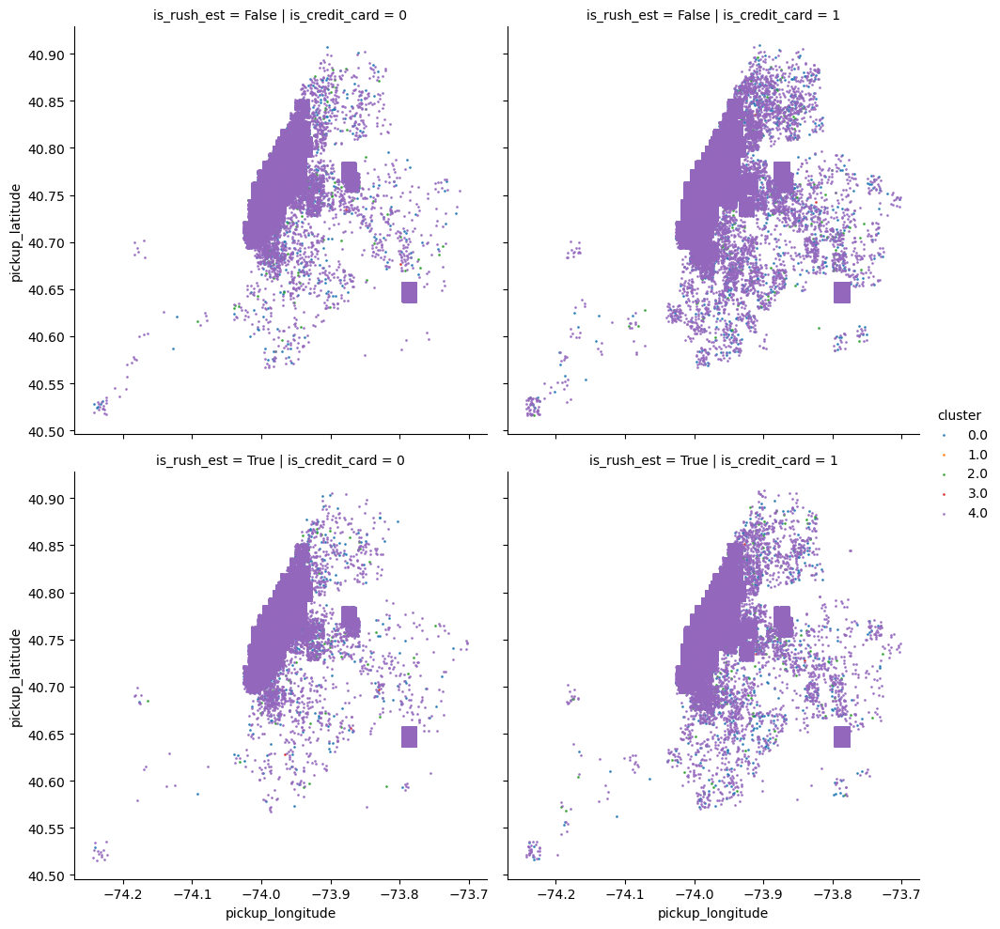

In [29]:
# Add a few interesting variables to help summarize the data
gdf_plot = gdf.copy()
gdf_plot["cluster"] = clusters_gpu
gdf_plot["short_trip"] = gdf_plot["trip_distance"] < 1.01 # About the 25th percentile
gdf_plot["is_rush_est"] = ((gdf_plot.hour >= 10) & (gdf_plot.hour <= 14)) | \
                                ((gdf_plot.hour >= 21) & (gdf_plot.hour <= 24))

# actually do the plot
sns.lmplot(data=gdf_plot.to_pandas(), x="pickup_longitude", y="pickup_latitude", x_jitter=0.01, y_jitter=0.01,
           hue="cluster", col="is_credit_card", row="is_rush_est", fit_reg=False, scatter_kws={"s": 1})

In [30]:
## DRAFT - try umap

gdf_sample = gdf.sample(50000).reset_index()

umap = cuml.manifold.UMAP() 
umap_out = umap.fit_transform(
     cuml.preprocessing.RobustScaler().fit_transform(gdf_sample))

gdf_sample["umap_x"] = umap_out.iloc[:,0]
gdf_sample["umap_y"] = umap_out.iloc[:,1]

In [31]:
import hvplot.cudf
import holoviews as hv

# generate hvplot points chart using cudf DataFrame
gdf_sample.hvplot.scatter(x="umap_x", y="umap_y", by=["is_weekend"], s=0.1,
                          subplots=True, hover_cols="all").opts(
    title="Scatter Plot", width=500, height=500
)

:NdLayout   [is_weekend]
   :Scatter   [umap_x]   (umap_y,level_0,index,passenger_count,trip_distance,rate_code,pickup_location,dropoff_location,fare_amount,airport_fee,is_credit_card,trip_index,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,hour,year,month,day,day_of_week,is_weekend,h_distance)

In [32]:
explorer = hvplot.explorer(gdf_sample)
explorer.param.set_param(kind='scatter', x='umap_x', y="umap_y")
explorer

hvDataFrameExplorer(axes=Axes(explorer=..., height=None, legend='right', logx=False, logy=False, name='Axes01263', responsive=False, shared_axes=True, width=None, xlim=None, ylim=None), by=[], colormapping=Colormapping(clim=None, cmap='kbc_r', cnorm='linear', color=None, colorbar=None, explorer=..., name='Colormapping01293', rescale_discrete_levels=True, symmetric=False), groupby=[], kind='scatter', labels=Labels(clabel='', explorer=..., fontscale=1, name='Labels01314', rot=0, title='', xlabel='', ylabel=''), name='hvDataFrameExplorer01248', operations=Operations(aggregator=None, datashade=False, dynspread=False, explorer=..., name='Operations01334', rasterize=False, x_sampling=None, y_sampling=None), style=Style(alpha=1, explorer=..., name='Style01354'), x='umap_x', y='umap_y', y_multi=[], z=None)

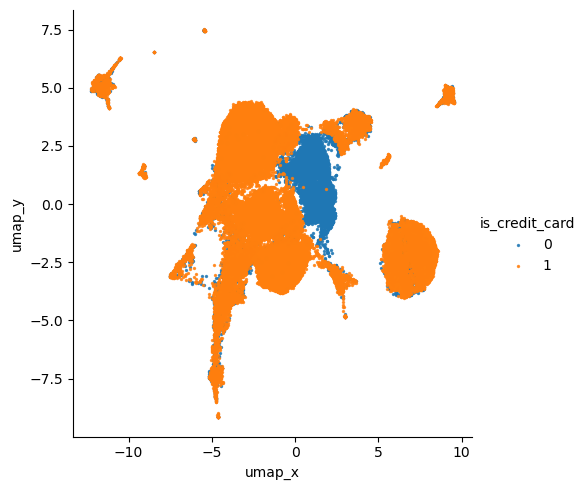

In [33]:
sns.lmplot(data=gdf_sample.to_pandas(), x="umap_x", y="umap_y",
           hue="is_credit_card", fit_reg=False, scatter_kws={"s": 2})

# Build a supervised model to predict payment form

Let's imagine you're a taxi operator trying to understand consumer payment behavior. What types of rides will be paid by credit card and what types via cash? Let's build a predictive model to help us understand.

## Start by splitting training and test data.

We'll want to know how accurate our model is, so let's start by splitting the dataset into "train" and "test" subsets randomly.

In [30]:
%time

# First let's split using Pandas and scikit-learn
import sklearn

y_df = df["is_credit_card"]
X_df = df.drop(columns="is_credit_card")

# Split our dataframes
X_train_df, X_test_df, y_train_df, y_test_df = sklearn.model_selection.train_test_split(X_df, y_df)

# Create array versions of these dataframes
X_train_np, X_test_np = (X_train_df.to_numpy(np.float32), X_test_df.to_numpy(np.float32))
y_train_np, y_test_np = (y_train_df.to_numpy(np.float32), y_test_df.to_numpy(np.float32))

len(X_train_df)

CPU times: user 3 µs, sys: 1 µs, total: 4 µs
Wall time: 15 µs


858792

When we think of ML, we often think of running large predictive models. But scikit-learn also provides a huge toolbox of utilities like preprocessing, data splitting, and more that are essential for ML practitioners. cuML contains GPU-based analogues of these utilities so that your data does not need to take a round trip back to CPU just to partition it.

In [31]:
%%time

# Now do the same on GPU

y_gdf = gdf["is_credit_card"]
X_gdf = gdf.drop(columns="is_credit_card")

# Split our dataframes
X_train_gdf, X_test_gdf, y_train_gdf, y_test_gdf = sklearn.model_selection.train_test_split(X_gdf, y_gdf)

# Create array versions of these dataframes
X_train_gpu, X_test_gpu = (X_train_gdf.to_cupy(np.float32), X_test_gdf.to_cupy(np.float32))
y_train_gpu, y_test_gpu = (y_train_gdf.to_cupy(np.float32), y_test_gdf.to_cupy(np.float32))

len(X_train_gdf)

CPU times: user 210 ms, sys: 35.6 ms, total: 246 ms
Wall time: 241 ms


858792

In [32]:
X_gdf.columns

Index(['passenger_count', 'trip_distance', 'rate_code', 'pickup_location',
       'dropoff_location', 'fare_amount', 'airport_fee', 'trip_index',
       'pickup_latitude', 'pickup_longitude', 'dropoff_latitude',
       'dropoff_longitude', 'hour', 'year', 'month', 'day', 'day_of_week',
       'is_weekend', 'h_distance'],
      dtype='object')

### Fit a simple supervised model with cuML

cuML supports a large range of supervised models, all emulating the scikit-learn interfaces. See the README (https://github.com/rapidsai/cuml) for a recent list. Here, we'll try a very common but powerful model - a random forest ensemble for classification. Specifically, we want to classify whether the trip was paid for by credit card (the positive class) or not.

In [33]:
from sklearn.ensemble import RandomForestClassifier as skRandomForestClassifier
from cuml.ensemble import RandomForestClassifier as cuRandomForestClassifier

In [34]:
%%time

# Scikit-learn will parallelize over all CPU cores with n_jobs=-1

sk_model = skRandomForestClassifier(n_estimators=250, n_jobs=-1)
sk_model.fit(X_train_np, y_train_np)

CPU times: user 18min 28s, sys: 11.1 s, total: 18min 39s
Wall time: 53.2 s


RandomForestClassifier(n_estimators=250, n_jobs=-1)

In [35]:
%%time

# TODO: Build a similar model on GPU with cuML

cuml_model = cuRandomForestClassifier(n_estimators=250)
cuml_model.fit(X_train_gpu, y_train_gpu)

CPU times: user 21.6 s, sys: 252 ms, total: 21.8 s
Wall time: 7.28 s


RandomForestClassifier()

Accuracy:  0.7458333969116211
AUC:  0.6393241882324219


<Axes: ylabel='Density'>

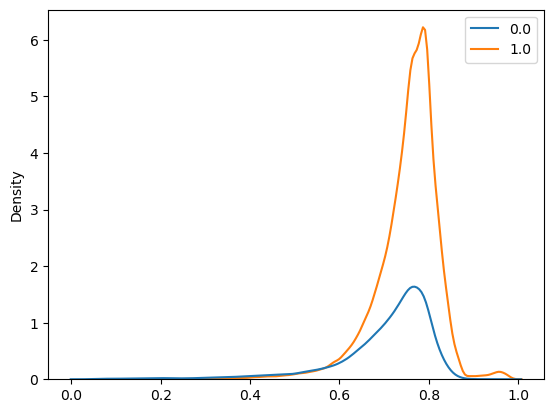

In [36]:
# Let's use the model to predict from the test set and evaluate the predictions' accuracy

rf_predictions = cuml_model.predict(X_test_gpu)

# Compute the probability that the transaction used a credit card, according to our model
rf_probabilities = cuml_model.predict_proba(X_test_gpu)[:,1]

## Just as cuML provides utilities for data preprocessing and splitting, it also provides a
## wide set of GPU-accelerated metrics, like accuracy and AUC score. These are fast and
## ensure you don't need to fall back to CPU for any of your pipeline.
print("Accuracy: ", cuml.metrics.accuracy.accuracy_score(y_test_gpu, rf_predictions))
print("AUC: ", cuml.metrics.roc_auc_score(y_test_gpu, rf_probabilities))

sns.kdeplot(x=rf_probabilities.get(), hue=y_test_gpu.get())

In [37]:
## XXX Drop this before final - just for debugging

featimp = pd.DataFrame({
    "feat": X_df.columns,
    "imp": sk_model.feature_importances_})
featimp.sort_values("imp")

,feat,imp
14,month,0.000004
13,year,0.000004
6,airport_fee,0.000004
2,rate_code,0.002380
17,is_weekend,0.002646
16,day_of_week,0.012766
15,day,0.015498
8,pickup_latitude,0.019037
9,pickup_longitude,0.019107
11,dropoff_longitude,0.022102
